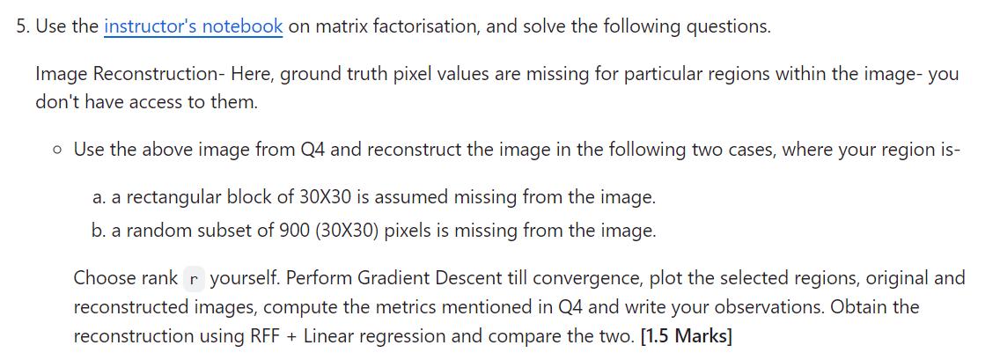

In [29]:
!pip install einops

In [30]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

import numpy as np
import pandas as pd

# Remove all the warnings
import warnings
warnings.filterwarnings('ignore')

# Set env CUDA_LAUNCH_BLOCKING=1
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Retina display
%config InlineBackend.figure_format = 'retina'

try:
    from einops import rearrange
except ImportError:
    %pip install einops
    from einops import rearrange



In [31]:
!pip install einops

In [32]:
def factorize(A, k, device=torch.device("cpu")):

    A = A.to(device)

    # Randomly initialize W and H
    W = torch.randn(A.shape[0], k, requires_grad=True, device=device)
    H = torch.randn(k, A.shape[1], requires_grad=True, device=device)

    # Optimizer
    optimizer = optim.Adam([W, H], lr=0.01)
    mask = ~torch.isnan(A)

    # Train the model
    for i in range(1000):
        # Compute the loss
        diff_matrix = torch.mm(W, H) - A
        diff_vector = diff_matrix[mask]
        loss = torch.norm(diff_vector)

        # Zero the gradients
        optimizer.zero_grad()

        # Backpropagate
        loss.backward()

        # Update the parameters
        optimizer.step()

    return W, H, loss

In [33]:
def generate_random_subset(image_shape, num_pixels = 900):

  # Generate random indices for missing pixels
  missing_indices = np.random.choice(image_shape[0] * image_shape[1], num_pixels, replace=False)

  # Create mask with random missing pixels
  mask = np.zeros(image_shape, dtype=bool)
  mask.flat[missing_indices] = True
  return mask


def generate_rectangular_block(image_shape, block_size = (30, 30)):

  # Choose random starting position
  x, y = np.random.randint(0, image_shape[0] - block_size[0] + 1), np.random.randint(0, image_shape[1] - block_size[1] + 1)

  # Create mask with missing block
  mask = np.zeros(image_shape, dtype=bool)
  mask[x:x + block_size[0], y:y + block_size[1]] = True
  return mask


dog.jpg exists
torch.Size([3, 1365, 2048])


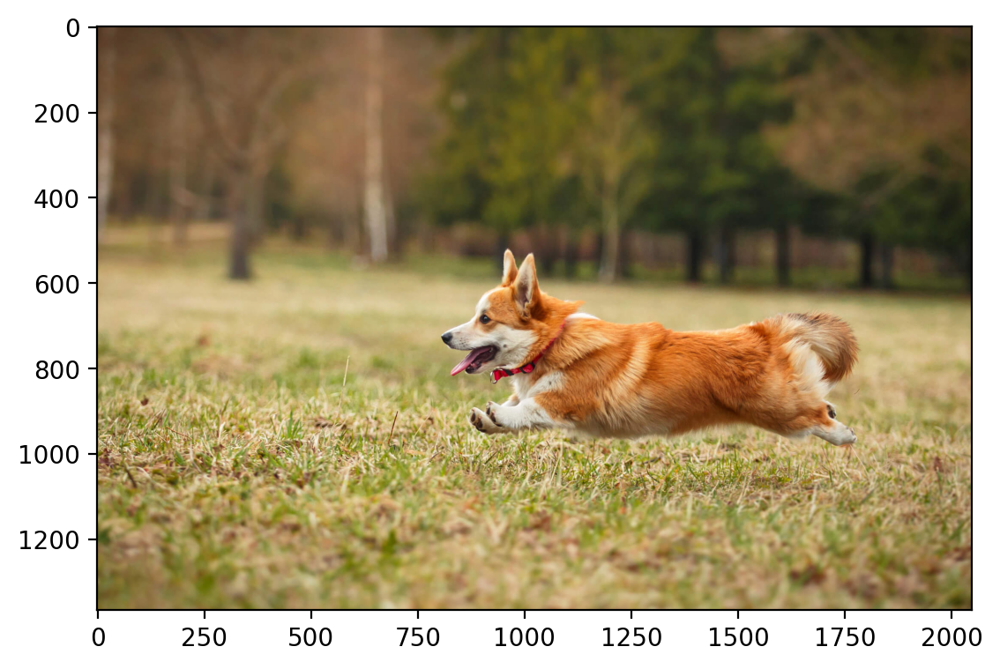

In [34]:
if os.path.exists("dog.jpg"):
    print('dog.jpg exists')
else:
    !wget https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg -O dog.jpg

# Read in a image from torchvision
img = torchvision.io.read_image("dog.jpg")
print(img.shape)

plt.imshow(rearrange(img, 'c h w -> h w c').numpy())

tensor([[[0.7686, 0.7686, 0.7686,  ..., 0.5451, 0.5451, 0.5412],
         [0.7725, 0.7725, 0.7725,  ..., 0.5686, 0.5686, 0.5647],
         [0.7765, 0.7765, 0.7765,  ..., 0.5882, 0.5843, 0.5843],
         ...,
         [0.7961, 0.7373, 0.7176,  ..., 0.5843, 0.5725, 0.5490],
         [0.8471, 0.7843, 0.7451,  ..., 0.6039, 0.5686, 0.5569],
         [0.8784, 0.8196, 0.7686,  ..., 0.6275, 0.5804, 0.5686]],

        [[0.6941, 0.6941, 0.6941,  ..., 0.5137, 0.5137, 0.5098],
         [0.6980, 0.6980, 0.6980,  ..., 0.5255, 0.5255, 0.5216],
         [0.7020, 0.7020, 0.7020,  ..., 0.5451, 0.5412, 0.5412],
         ...,
         [0.7686, 0.7098, 0.6863,  ..., 0.2824, 0.2706, 0.2431],
         [0.8157, 0.7569, 0.7137,  ..., 0.3059, 0.2667, 0.2431],
         [0.8431, 0.7882, 0.7333,  ..., 0.3294, 0.2706, 0.2588]],

        [[0.4745, 0.4745, 0.4745,  ..., 0.3294, 0.3294, 0.3255],
         [0.4784, 0.4784, 0.4784,  ..., 0.3451, 0.3451, 0.3412],
         [0.4824, 0.4824, 0.4824,  ..., 0.3647, 0.3608, 0.

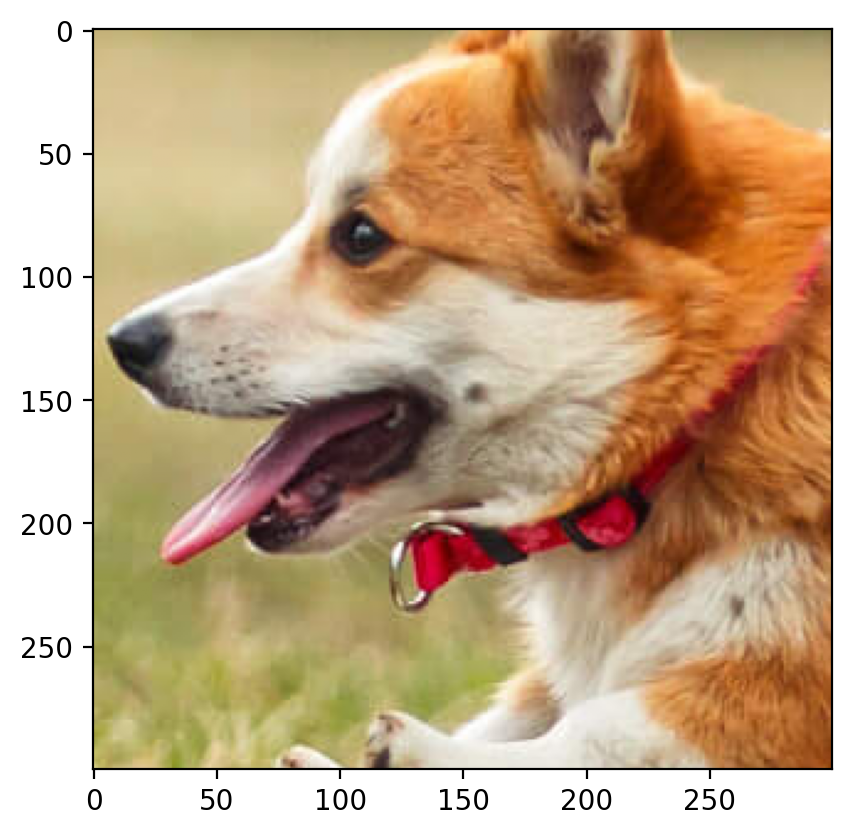

In [35]:
from sklearn import preprocessing

scaler_img = preprocessing.MinMaxScaler().fit(img.reshape(-1, 1))
img_scaled = scaler_img.transform(img.reshape(-1, 1)).reshape(img.shape)

img_scaled = torch.tensor(img_scaled)

img_scaled = img_scaled.to(device)


crop = torchvision.transforms.functional.crop(img_scaled.cpu(), 600, 800, 300, 300)
crop.shape

plt.imshow(rearrange(crop, 'c h w -> h w c').cpu().numpy())

crop = crop.to(device)
print(crop)


In [36]:
def calculate_rmse(pred_img, original_img):

    squared_diff = (pred_img - original_img) ** 2
    mean_squared_diff = torch.mean(squared_diff[~squared_diff.isnan()])
    rmse = torch.sqrt(mean_squared_diff)
    return rmse.item()

def calculate_psnr(rmse):

    max_pixel_value = 1
    psnr = 20 * np.log10(max_pixel_value / rmse)
    return psnr


# Reconstruction Using Matrix Factorization (Gradient Descent)
---

RMSE for N = 30: 0.03193430966415708
PSNR for N = 30: 29.914849354195553



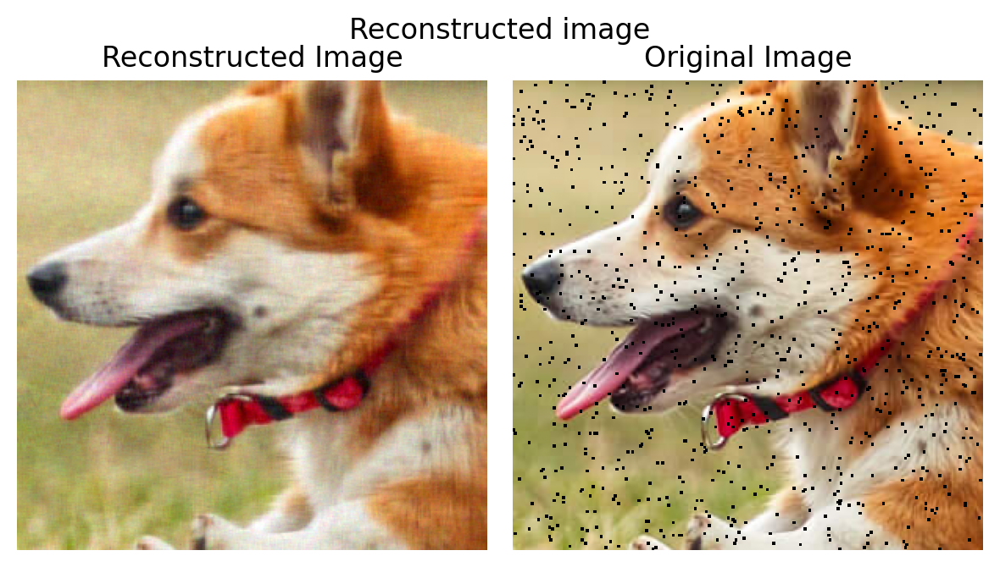

In [37]:
mask_random = generate_random_subset(crop[0].shape, 900)

A_chs = []
masked_crop = []
for channel in crop:
  channel_copy = channel.clone()
  channel_copy[mask_random] = float('nan')
  masked_crop.append(channel_copy)

  W_ch, H_ch, loss = factorize(channel_copy, 100, device=device)
  A_ch = torch.matmul(W_ch, H_ch)
  A_chs.append(A_ch)

A_pred = torch.stack(A_chs)
masked_rand_crop = torch.stack(masked_crop)

fig = plt.figure(figsize=(6, 4))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

ax0 = plt.subplot(gs[0])
ax1 = plt.subplot(gs[1])


ax0.imshow(A_pred.detach().cpu().permute(1, 2, 0))
ax0.set_title("Reconstructed Image")


ax1.imshow(masked_rand_crop.cpu().permute(1, 2, 0))
ax1.set_title("Original Image")

rmse = (calculate_rmse(A_pred.detach(), crop))
psnr = calculate_psnr(rmse)

print(f"RMSE for N = 30:", rmse)
print(f"PSNR for N = 30:", psnr)
print()
    
for a in [ax0, ax1]:
    a.axis("off")


fig.suptitle("Reconstructed image", y=0.9)
plt.tight_layout()

RMSE for N = 30: 0.04176683837034455
PSNR for N = 30: 27.58336796670185



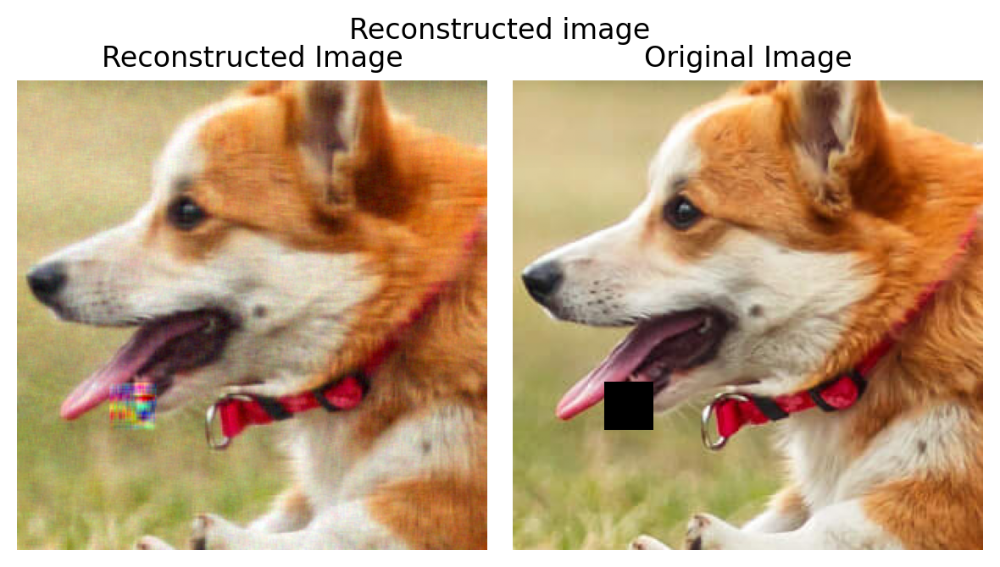

In [53]:
mask_rect = generate_rectangular_block(crop[0].shape, (30, 30))

A_chs = []
masked_crop = []
for channel in crop:
  channel_copy = channel.clone()
  channel_copy[mask_rect] = float('nan')
  masked_crop.append(channel_copy)

  W_ch, H_ch, loss = factorize(channel_copy, 100, device=device)
  A_ch = torch.matmul(W_ch, H_ch)
  A_chs.append(A_ch)

A_pred = torch.stack(A_chs)
masked_rect_crop = torch.stack(masked_crop)

fig = plt.figure(figsize=(6, 4))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

ax0 = plt.subplot(gs[0])
ax1 = plt.subplot(gs[1])

ax0.imshow(A_pred.detach().cpu().permute(1, 2, 0))
ax0.set_title("Reconstructed Image")


ax1.imshow(masked_rect_crop.cpu().permute(1, 2, 0))
ax1.set_title("Original Image")

rmse = (calculate_rmse(A_pred.detach(), crop))
psnr = calculate_psnr(rmse)

print(f"RMSE for N = 30:", rmse)
print(f"PSNR for N = 30:", psnr)
print()

for a in [ax0, ax1]:
    a.axis("off")


fig.suptitle("Reconstructed image", y=0.9)
plt.tight_layout()

For structured removal of pixels as a rectangle, the PSNR value is lower than that obtained when pixels are removed randomly. The model is able to better predict the reconstructed image when random data pixels are removed.

For random pixel removal, the output is quite good but with a lower resolution, as visible to the naked eye.

# Reconstruction using RFF + Linear Regression
---

In [39]:
def create_coordinate_map(img, scale=1):
    """
    img: torch.Tensor of shape (num_channels, height, width)

    return: tuple of torch.Tensor of shape (height * width, 2) and torch.Tensor of shape (height * width, num_channels)
    """

    num_channels, height, width = img.shape

    # Create a 2D grid of (x,y) coordinates (h, w)
    # width values change faster than height values
    w_coords = torch.arange(0, width,  1/scale).repeat(int(height*scale), 1)
    h_coords = torch.arange(0, height, 1/scale).repeat(int(width*scale), 1).t()
    w_coords = w_coords.reshape(-1)
    h_coords = h_coords.reshape(-1)

    # Combine the x and y coordinates into a single tensor
    X = torch.stack([h_coords, w_coords], dim=1).float()

    # Move X to GPU if available
    X = X.to(device)

    # Reshape the image to (h * w, num_channels)
    Y = rearrange(img, 'c h w -> (h w) c').float()
    return X, Y

# MinMaxScaler from -1 to 1
def MinMax(dog_X):

    scaler_X = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(dog_X.cpu())

    # Scale the X coordinates
    dog_X_scaled = scaler_X.transform(dog_X.cpu())

    # Move the scaled X coordinates to the GPU
    dog_X_scaled = torch.tensor(dog_X_scaled).to(device)

    # Set to dtype float32
    dog_X_scaled = dog_X_scaled.float()
    return dog_X_scaled


In [49]:
class LinearModel(nn.Module):
    def __init__(self, in_features, out_features):
        super(LinearModel, self).__init__()
        self.linear = nn.Linear(in_features, out_features)

    def forward(self, x):
        return self.linear(x)

import torch

def train(net, lr, X, Y, epochs, verbose=True, out=0):
  """
  Trains the model `net` with learning rate `lr` on data `X` and targets `Y` for `epochs`.

  Args:
      net: torch.nn.Module, the model to train.
      lr: float, the learning rate.
      X: torch.Tensor of shape (num_samples, 2), the input data.
      Y: torch.Tensor of shape (num_samples, 3), the target labels.
      epochs: int, the number of training epochs.
      verbose: bool, whether to print training information (default: True).
      out: int, used for conditional printing (unused in this modification).

  Returns:
      float, the final mean squared error loss.
  """

  criterion = nn.MSELoss()  # Use 'none' reduction for per-sample loss

  optimizer = torch.optim.Adam(net.parameters(), lr=lr)

  for name, param in net.named_parameters():
    if not param.requires_grad:
        param.requires_grad = True

  for epoch in range(epochs):
    optimizer.zero_grad()
    outputs = net(X)


    # Calculate per-sample MSE loss
    masked_outputs = torch.masked_select(outputs, ~torch.isnan(Y))  # Mask out nan values
    masked_Y = torch.masked_select(Y, ~torch.isnan(Y))  # Mask out nan values
    loss = criterion(masked_outputs, masked_Y)

    loss.backward()

    # for name, param in net.named_parameters():
    #   if param.grad is not None:
    #     print(f"Parameter name: {name}")
    #     print(f"Gradient: {param.grad}")

    optimizer.step()

    if verbose and epoch % 100 == 0:
      print(f"Epoch {epoch} loss: {loss.item():.6f}")

  return loss.item()


def plot_reconstructed_and_original_image(original_img, net, X, title="",scale=1):
    """
    net: torch.nn.Module
    X: torch.Tensor of shape (num_samples, 2)
    Y: torch.Tensor of shape (num_samples, 3)
    """
    num_channels, height, width = original_img.shape
    net.eval()
    with torch.no_grad():
        outputs = net(X)
        outputs = outputs.reshape(height*scale, width*scale, num_channels)
    fig = plt.figure(figsize=(6, 4))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])

    ax0.imshow(outputs.cpu())
    ax0.set_title("Reconstructed Image")


    ax1.imshow(original_img.cpu().permute(1, 2, 0))
    ax1.set_title("Original Image")

    for a in [ax0, ax1]:
        a.axis("off")
    
    rmse = (calculate_rmse(outputs.cpu(), crop.cpu().permute(1, 2, 0)))
    psnr = calculate_psnr(rmse)
    
    print()
    print(f"RMSE:", rmse)
    print(f"PSNR:", psnr)
    print()

    fig.suptitle(title, y=0.9)
    plt.tight_layout()

  # create RFF features
def create_rff_features(X, num_features, sigma):
    from sklearn.kernel_approximation import RBFSampler
    rff = RBFSampler(n_components=num_features, gamma=1/(2 * sigma**2), random_state = 42)
    X = X.cpu().numpy()
    X = rff.fit_transform(X)
    return torch.tensor(X, dtype=torch.float32).to(device)



tensor([[  0,   0, 164],
        [  0,   0, 218],
        [  0,   0, 231],
        ...,
        [  2, 299,  89],
        [  2, 299, 208],
        [  2, 299, 272]], device='cuda:0')
Epoch 0 loss: 0.364454
Epoch 100 loss: 0.008191
Epoch 200 loss: 0.002944
Epoch 300 loss: 0.002834
Epoch 400 loss: 0.002781
Epoch 500 loss: 0.002745
Epoch 600 loss: 0.002718
Epoch 700 loss: 0.002698
Epoch 800 loss: 0.002682
Epoch 900 loss: 0.002670
Epoch 1000 loss: 0.002659
Epoch 1100 loss: 0.002651
Epoch 1200 loss: 0.002645
Epoch 1300 loss: 0.002639
Epoch 1400 loss: 0.002634
Epoch 1500 loss: 0.002630
Epoch 1600 loss: 0.002626
Epoch 1700 loss: 0.002623
Epoch 1800 loss: 0.002620
Epoch 1900 loss: 0.002618
RMSE: 0.05112860783564939
PSNR: 25.82672064753328



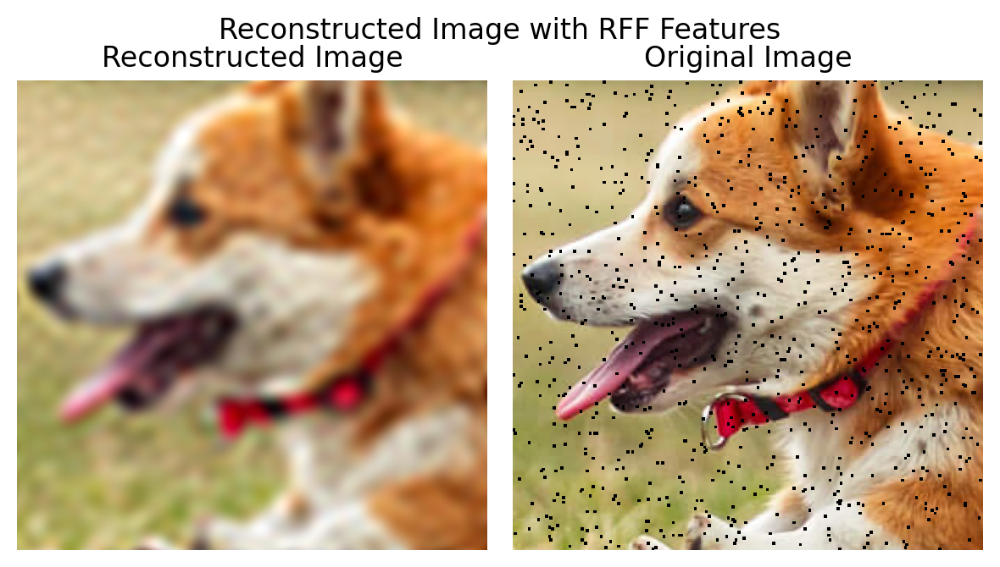

In [48]:
# A random subset of 900 (30X30) pixels is missing from the image
print(torch.nonzero(torch.isnan(masked_rand_crop.float())))

dog_X, dog_Y = create_coordinate_map(masked_rand_crop.float())

X_rff = create_rff_features(dog_X, 5000, 7)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.005, X_rff, dog_Y, 2000, out = 1)

plot_reconstructed_and_original_image(masked_rand_crop, net, X_rff, title="Reconstructed Image with RFF Features")



torch.Size([3, 300, 300])

Epoch 0 loss: 0.371478
Epoch 100 loss: 0.005660
Epoch 200 loss: 0.003840
Epoch 300 loss: 0.003585
Epoch 400 loss: 0.003458
Epoch 500 loss: 0.003380
Epoch 600 loss: 0.003328
Epoch 700 loss: 0.003291
Epoch 800 loss: 0.003264
Epoch 900 loss: 0.003244
Epoch 1000 loss: 0.003229
Epoch 1100 loss: 0.003217
Epoch 1200 loss: 0.003208
Epoch 1300 loss: 0.003201
Epoch 1400 loss: 0.003195
Epoch 1500 loss: 0.003189
Epoch 1600 loss: 0.003185
Epoch 1700 loss: 0.003181
Epoch 1800 loss: 0.003177
Epoch 1900 loss: 0.003174

RMSE: 0.0576297083915091
PSNR: 24.787071559189773



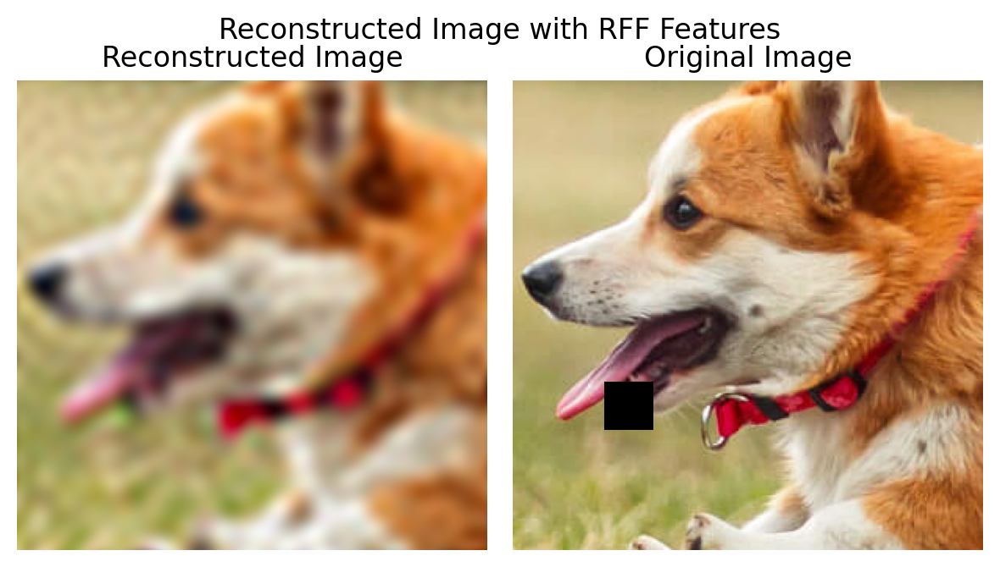

In [54]:
# A rectangular block of 30X30 is assumed missing from the image

dog_X, dog_Y = create_coordinate_map(masked_rect_crop.float())
dog_X_scaled = MinMax(dog_X)

X_rff = create_rff_features(dog_X_scaled, 5000, 0.06)

net = LinearModel(X_rff.shape[1], 3 )
net.to(device)

train(net, 0.005, X_rff, dog_Y, 2000)

plot_reconstructed_and_original_image(masked_rect_crop, net, X_rff, title="Reconstructed Image with RFF Features")



The RFF + Linear Regression approach gives a poorer result in both cases - structured and unstructured removal of pixels. The result is worse in the case of structured removal as the PSNR is lower by almost 3 dB. 

This result is also likely because we weren't able to leverage higher number of features in the RFF implementation due to GPU restrictions.

# Reconstruction Using Matrix Factorization (GD) for Varying Region Sizes
---

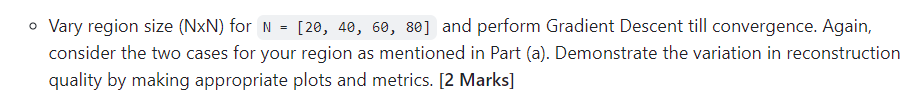

RMSE for N = 20: 0.03417064871735585
PSNR for N = 20: 29.326935523999204

RMSE for N = 40: 0.05390693508284751
PSNR for N = 40: 25.367107191824886

RMSE for N = 60: 0.09174234159010683
PSNR for N = 60: 20.748603586525853

RMSE for N = 80: 0.14694252762382162
PSNR for N = 80: 16.657049878694053



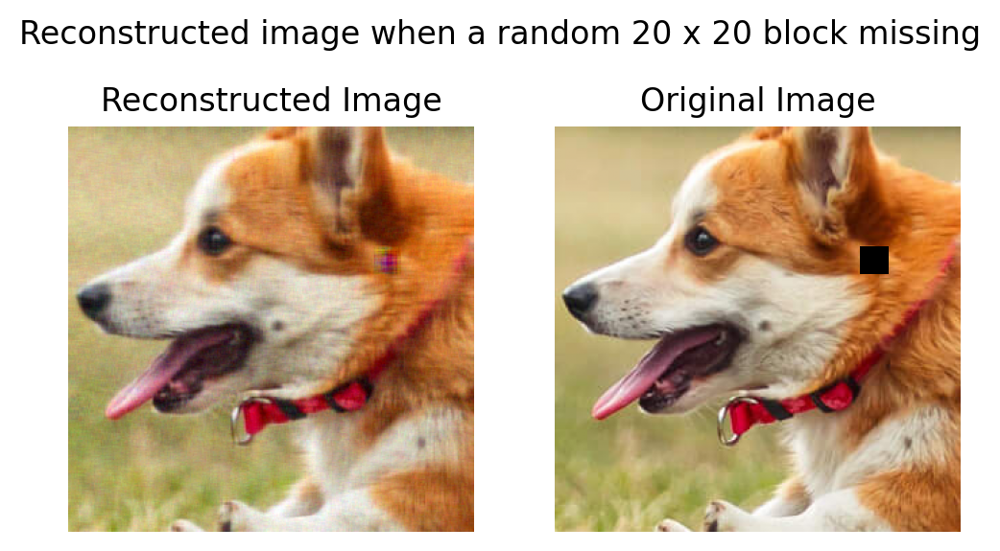

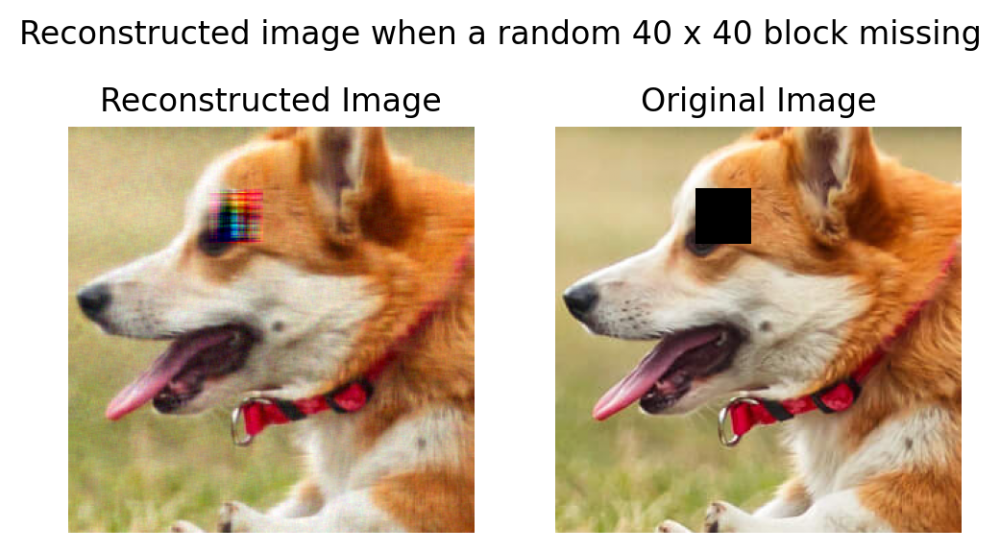

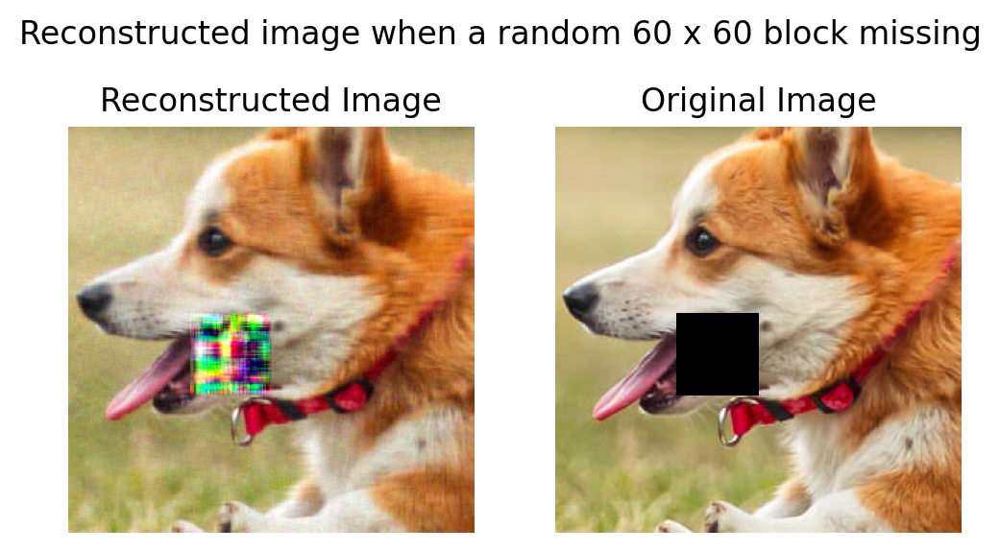

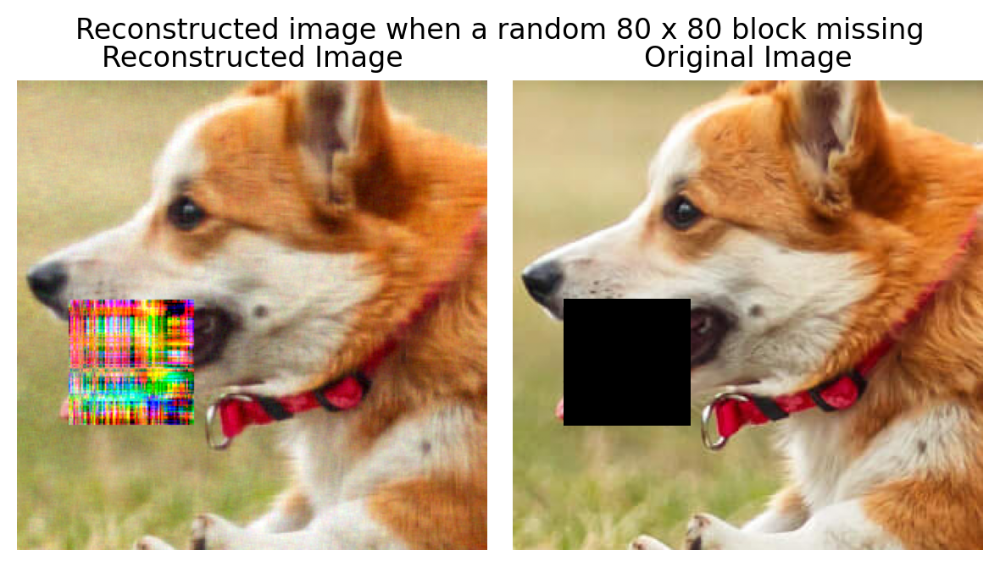

In [43]:
for N in (20,40,60,80):
    mask_rect = generate_rectangular_block(crop[0].shape, (N, N))

    A_chs = []
    masked_crop = []
    for channel in crop:
      channel_copy = channel.clone()
      channel_copy[mask_rect] = float('nan')
      masked_crop.append(channel_copy)

      W_ch, H_ch, loss = factorize(channel_copy, 100, device=device)
      A_ch = torch.matmul(W_ch, H_ch)
      A_chs.append(A_ch)

    A_pred = torch.stack(A_chs)
    masked_rect_crop = torch.stack(masked_crop)

    fig = plt.figure(figsize=(6, 4))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])

    ax0.imshow(A_pred.detach().cpu().permute(1, 2, 0))
    ax0.set_title("Reconstructed Image")


    ax1.imshow(masked_rect_crop.cpu().permute(1, 2, 0))
    ax1.set_title("Original Image")

    for a in [ax0, ax1]:
        a.axis("off")
    
        
    rmse = (calculate_rmse(A_pred.detach(), crop))
    psnr = calculate_psnr(rmse)

    print(f"RMSE for N = {N}:", rmse)
    print(f"PSNR for N = {N}:", psnr)
    print()

    fig.suptitle(f"Reconstructed image when a random {N} x {N} block missing", y=0.9)
    fig.show()
    
plt.tight_layout()

As the size of the square patch increases, the PSNR comes down by almost 4 in each case, and the RMSE also increases as the the model finds it increasingly harder to train on with fewer data pixels.

RMSE for N = 20: 0.03144360732737251
PSNR for N = 20: 30.049352717981254

RMSE for N = 40: 0.03186174777702207
PSNR for N = 40: 29.93460809292182

RMSE for N = 60: 0.032183550820221535
PSNR for N = 60: 29.847320835221414

RMSE for N = 80: 0.03318454960751702
PSNR for N = 80: 29.58128144761517



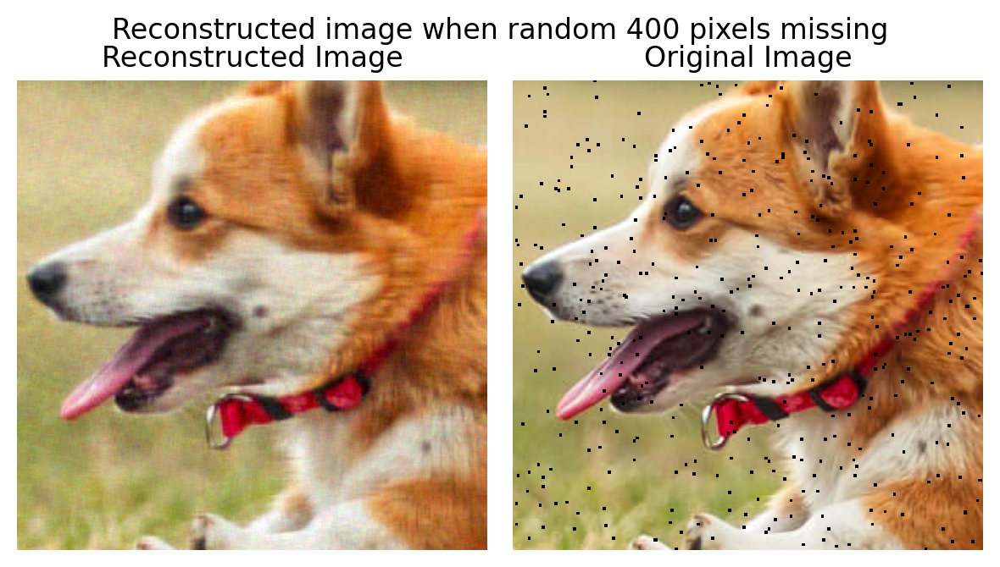

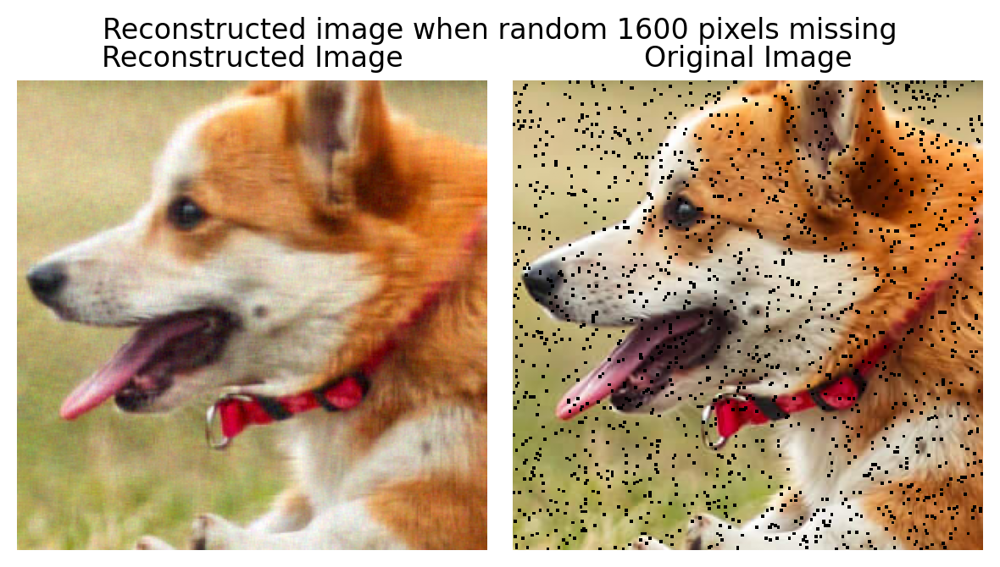

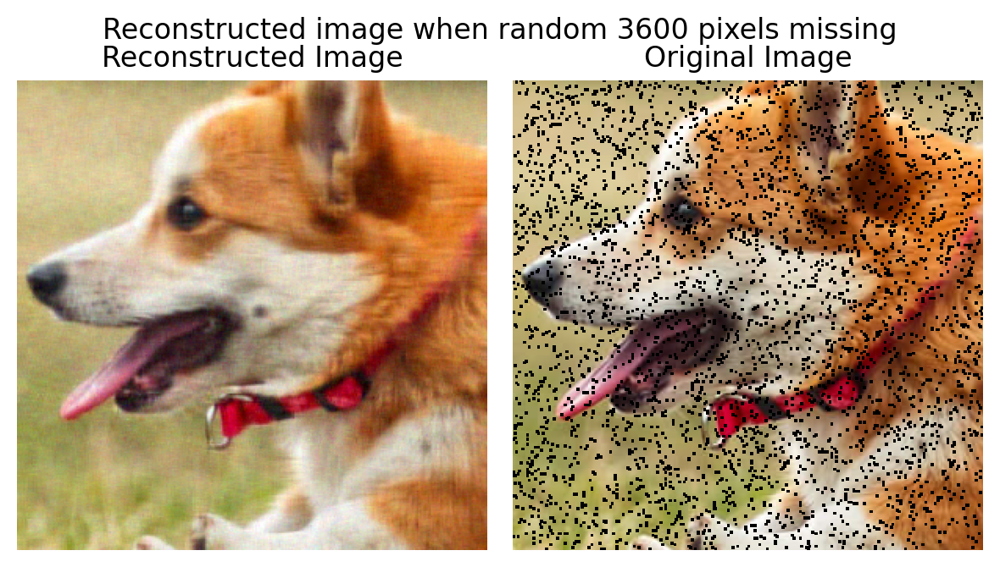

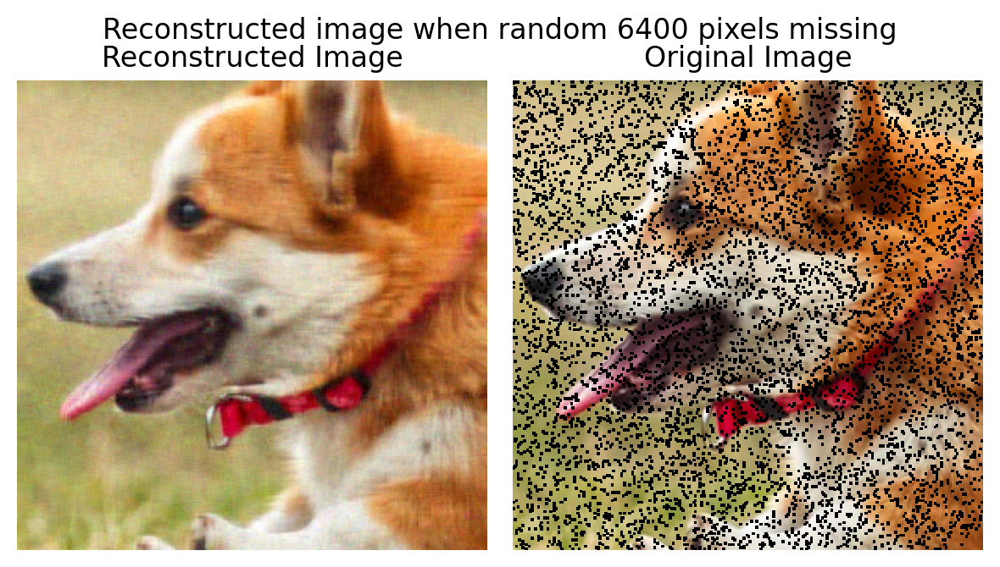

In [55]:
for N in (20,40,60,80):
    mask_random = generate_random_subset(crop[0].shape, N*N)

    A_chs = []
    masked_crop = []
    for channel in crop:
      channel_copy = channel.clone()
      channel_copy[mask_random] = float('nan')
      masked_crop.append(channel_copy)

      W_ch, H_ch, loss = factorize(channel_copy, 100, device=device)
      A_ch = torch.matmul(W_ch, H_ch)
      A_chs.append(A_ch)

    A_pred = torch.stack(A_chs)
    masked_rand_crop = torch.stack(masked_crop)

    fig = plt.figure(figsize=(6, 4))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])


    ax0.imshow(A_pred.detach().cpu().permute(1, 2, 0))
    ax0.set_title("Reconstructed Image")


    ax1.imshow(masked_rand_crop.cpu().permute(1, 2, 0))
    ax1.set_title("Original Image")

    for a in [ax0, ax1]:
        a.axis("off")

    rmse = (calculate_rmse(A_pred.detach(), crop))
    psnr = calculate_psnr(rmse)

    print(f"RMSE for N = {N}:", rmse)
    print(f"PSNR for N = {N}:", psnr)
    print()
    
    
    fig.suptitle(f"Reconstructed image when random {N * N} pixels missing", y=0.9)
    plt.tight_layout()

In the case of randomised removal of pixels, the PSNR drop is not significant. The model is able to predict exceptionally well even with almost 6400 pixels missing randomly from the image.

# Performing Matrix Factorisation using Alternating Least Squares
---

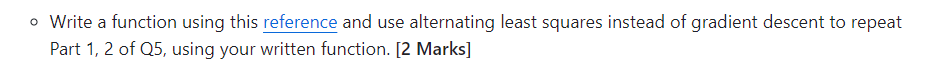

In [56]:
import math
from tqdm import trange

def factorize_alt_lst_sq(A, k, tol=1e-2, max_iter=100, device=torch.device("cpu")):
  """
  Performs matrix factorization of A into W and H using ALS with early stopping.

  Args:
      A: torch.Tensor of shape (m, n) representing the matrix to factorize.
      k: int, the number of latent factors.
      tol: float, the tolerance for convergence (default: 1e-6).
      max_iter: int, the maximum number of iterations (default: 100).
      device: torch.device, the device to use for computations (default: CPU).

  Returns:
      W: torch.Tensor of shape (m, k), the left factor matrix.
      H: torch.Tensor of shape (k, n), the right factor matrix.
      loss: float, the final reconstruction loss.
  """

  A = A.to(device)  # Move A to the specified device
  m, n = A.shape

  # Initialize W and H randomly
  W = torch.randn(m, k, device=device, dtype=A.dtype)
  H = torch.randn(k, n, device=device, dtype=A.dtype)
  
            
  # Loop for ALS iterations with early stopping
  prev_loss = float('inf')
  for iter in trange(max_iter):
    
    # Update W fixing H
    for i in range(A.shape[0]):
        mask = ~torch.isnan(A[i, :])
        H_masked = H[:, mask]
        A_masked = A[i, mask].t()

        s = torch.linalg.lstsq(H_masked.t(), A_masked).solution
        W[i,:]=s.t()

    # Update H fixing W
    for j in range(A.shape[1]):
        mask = ~torch.isnan(A[:, j])
        W_masked = W[mask, :]
        A_masked = A[mask, j]

        H[:, j] = torch.linalg.lstsq(W_masked, A_masked).solution
        
    mask = ~torch.isnan(A)
    diff_matrix = torch.mm(W, H)[mask] - A[mask]
    loss = torch.norm(diff_matrix.flatten())
    
    
    # Check for convergence and early stopping
    if abs(prev_loss - loss) < tol:
      break
    prev_loss = loss

  return W, H, loss.item()

  6%|▌         | 6/100 [00:15<04:08,  2.64s/it]



RMSE: 0.0063833465273223245
PSNR: 43.89903157507632



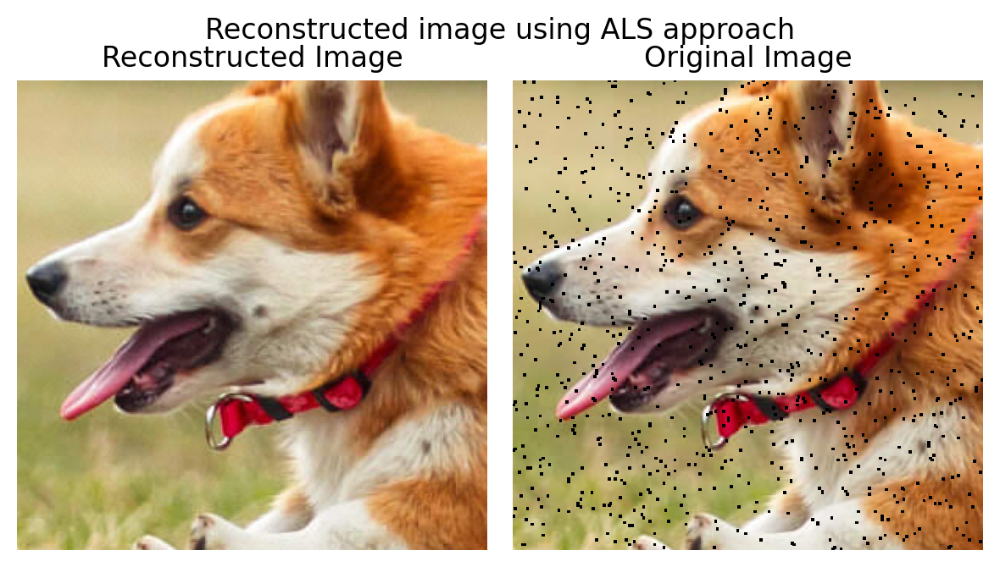

In [58]:
mask_random = generate_random_subset(crop[0].shape, 900)

A_chs = []
masked_crop = []
for channel in crop:
  channel_copy = channel.clone()
  channel_copy[mask_random] = float('nan')
  masked_crop.append(channel_copy)

  W_ch, H_ch, loss = factorize_alt_lst_sq(channel_copy.clone(), 100, device=device)
  A_ch = torch.matmul(W_ch, H_ch)
  A_chs.append(A_ch)

A_pred = torch.stack(A_chs)
masked_rand_crop = torch.stack(masked_crop)

fig = plt.figure(figsize=(6, 4))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

ax0 = plt.subplot(gs[0])
ax1 = plt.subplot(gs[1])


ax0.imshow(A_pred.detach().cpu().permute(1, 2, 0))
ax0.set_title("Reconstructed Image")


ax1.imshow(masked_rand_crop.cpu().permute(1, 2, 0))
ax1.set_title("Original Image")

rmse = (calculate_rmse(A_pred.detach().cpu().permute(1, 2, 0), crop.cpu().permute(1, 2, 0)))
psnr = calculate_psnr(rmse)

print()
print(f"RMSE:", rmse)
print(f"PSNR:", psnr)
print()

for a in [ax0, ax1]:
    a.axis("off")


fig.suptitle("Reconstructed image using ALS approach", y=0.9)
plt.tight_layout()

In the case of random removal of pixels, the alternating least squares approach seems to work better than the gradient descent approach, as can be seen from the value of `PSNR = 43.899`.

  5%|▌         | 5/100 [00:13<04:16,  2.70s/it]



RMSE: 0.06680337601579607
PSNR: 23.504031784027287



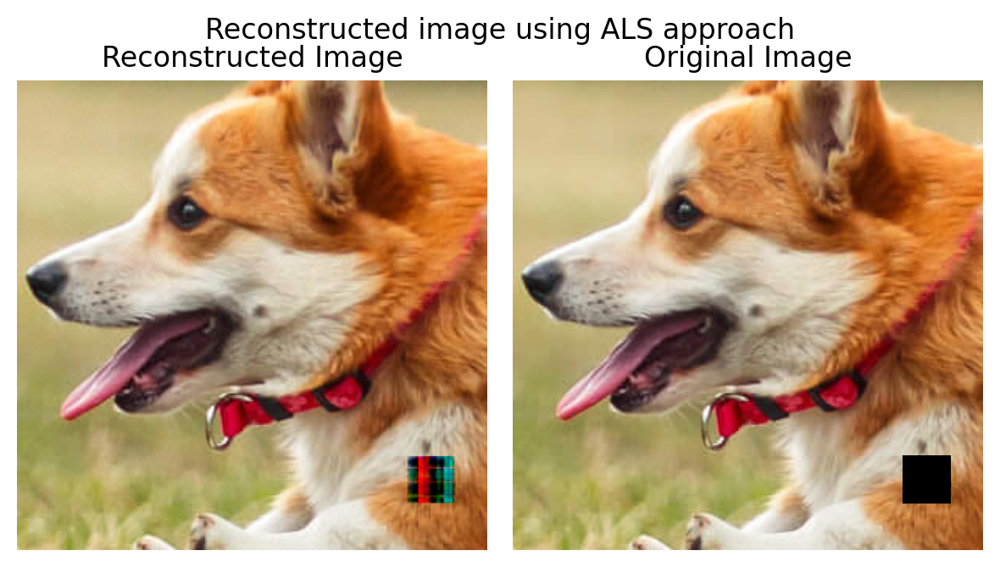

In [59]:
mask_rect = generate_rectangular_block(crop[0].shape, (30,30))

A_chs = []
masked_crop = []
for channel in crop:
  channel_copy = channel.clone()
  channel_copy[mask_rect] = float('nan')
  masked_crop.append(channel_copy)

  W_ch, H_ch, loss = factorize_alt_lst_sq(channel_copy.clone(), 100, device=device)
  A_ch = torch.matmul(W_ch, H_ch)
  A_chs.append(A_ch)

A_pred = torch.stack(A_chs)
masked_rect_crop = torch.stack(masked_crop)

fig = plt.figure(figsize=(6, 4))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

ax0 = plt.subplot(gs[0])
ax1 = plt.subplot(gs[1])


ax0.imshow(A_pred.detach().cpu().permute(1, 2, 0))
ax0.set_title("Reconstructed Image")


ax1.imshow(masked_rect_crop.cpu().permute(1, 2, 0))
ax1.set_title("Original Image")

rmse = (calculate_rmse(A_pred.detach().cpu().permute(1, 2, 0), crop.cpu().permute(1, 2, 0)))
psnr = calculate_psnr(rmse)

print()
print(f"RMSE:", rmse)
print(f"PSNR:", psnr)
print()

for a in [ax0, ax1]:
    a.axis("off")


fig.suptitle("Reconstructed image using ALS approach", y=0.9)
plt.tight_layout()

For a structured rectangular removal of pixels, the PSNR obtained using the *gradient descent approach* is better than the *alternating least squares* approach. The PSNR has dropped from `27` to `23`. 

  5%|▌         | 5/100 [00:13<04:16,  2.70s/it]


RMSE for N = 20: 0.04150759747233584
PSNR for N = 20: 27.637448071385794



  6%|▌         | 6/100 [00:15<04:05,  2.61s/it]


RMSE for N = 40: 0.11624187989495799
PSNR for N = 40: 18.692747502520547



  9%|▉         | 9/100 [00:22<03:45,  2.48s/it]


RMSE for N = 60: 0.15726471769514577
PSNR for N = 60: 16.067374006405753



 10%|█         | 10/100 [00:24<03:40,  2.45s/it]


RMSE for N = 80: 0.25603224322892937
PSNR for N = 80: 11.834106773869763



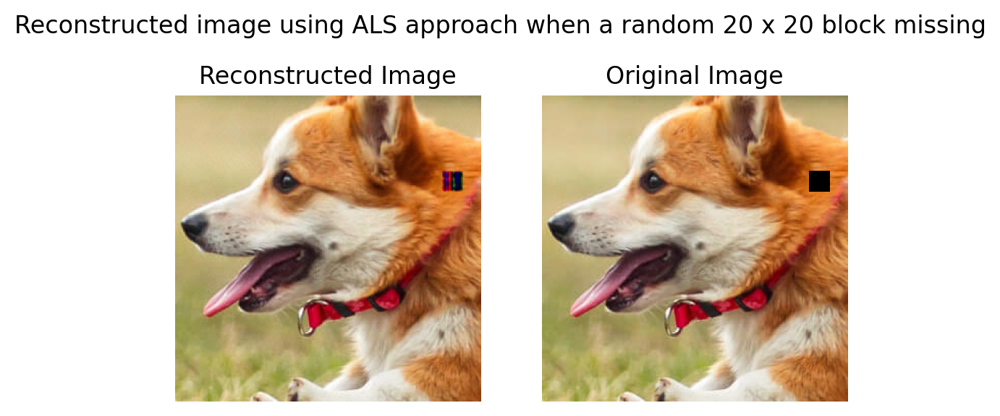

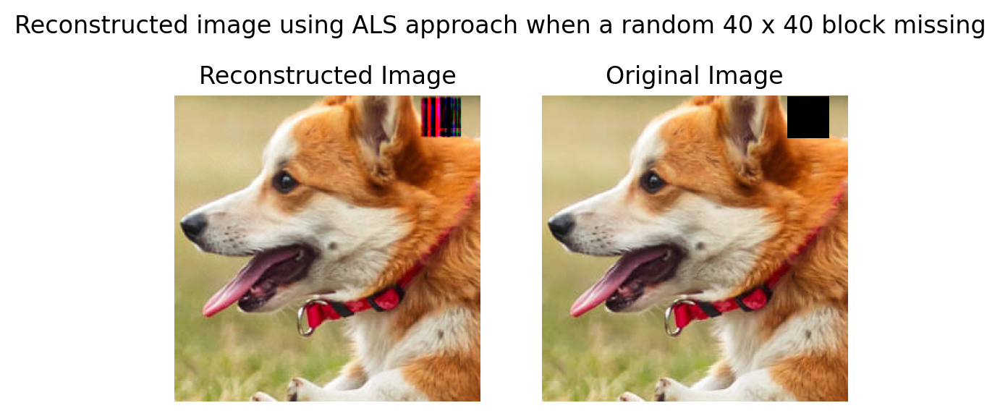

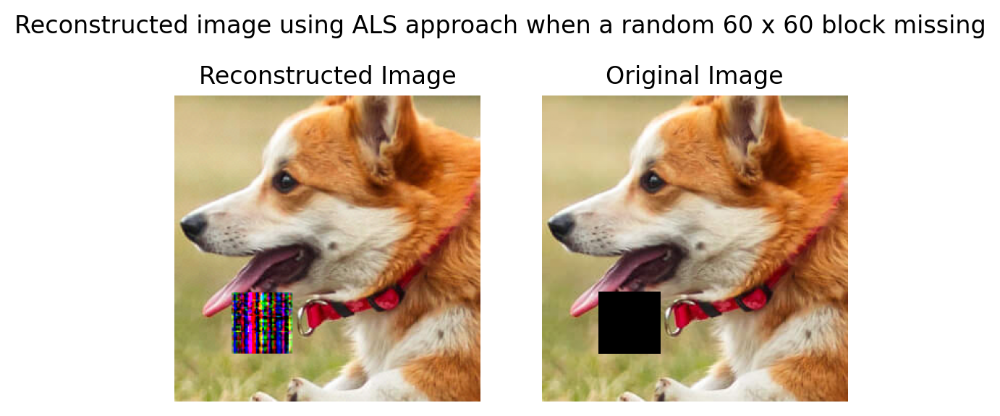

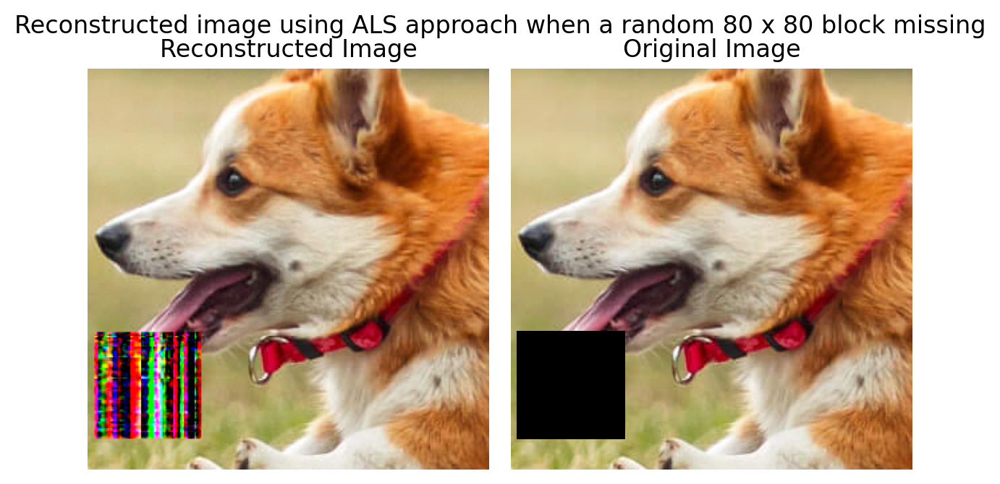

In [60]:
for N in (20,40,60,80):
    mask_rect = generate_rectangular_block(crop[0].shape, (N, N))

    A_chs = []
    masked_crop = []
    for channel in crop:
      channel_copy = channel.clone()
      channel_copy[mask_rect] = float('nan')
      masked_crop.append(channel_copy)

      W_ch, H_ch, loss = factorize_alt_lst_sq(channel_copy, 100, device=device)
      A_ch = torch.matmul(W_ch, H_ch)
      A_chs.append(A_ch)

    A_pred = torch.stack(A_chs)
    masked_rect_crop = torch.stack(masked_crop)

    fig = plt.figure(figsize=(6, 4))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])

    ax0.imshow(A_pred.detach().cpu().permute(1, 2, 0))
    ax0.set_title("Reconstructed Image")


    ax1.imshow(masked_rect_crop.cpu().permute(1, 2, 0))
    ax1.set_title("Original Image")

    for a in [ax0, ax1]:
        a.axis("off")
    
        
    rmse = (calculate_rmse(A_pred.detach(), crop))
    psnr = calculate_psnr(rmse)
    
    print(f"RMSE for N = {N}:", rmse)
    print(f"PSNR for N = {N}:", psnr)
    print()
    
    fig.suptitle(f"Reconstructed image using ALS approach when a random {N} x {N} block missing", y=0.9)
    fig.show()
    
plt.tight_layout()

While using the *alternating least squares* approach in the case of strucuted removal of pixels, the PSNR drops significantly with increase in patch size.

  6%|▌         | 6/100 [00:15<04:07,  2.63s/it]


RMSE for N = 20: 0.006274598551585457
PSNR for N = 20: 44.04828110182593



  6%|▌         | 6/100 [00:15<04:05,  2.61s/it]


RMSE for N = 40: 0.0064683793495000745
PSNR for N = 40: 43.78409036107806



  6%|▌         | 6/100 [00:15<04:04,  2.60s/it]


RMSE for N = 60: 0.0070335434626282445
PSNR for N = 60: 43.056516490913125



  7%|▋         | 7/100 [00:17<03:56,  2.54s/it]


RMSE for N = 80: 0.007715954011378182
PSNR for N = 80: 42.25220739004001



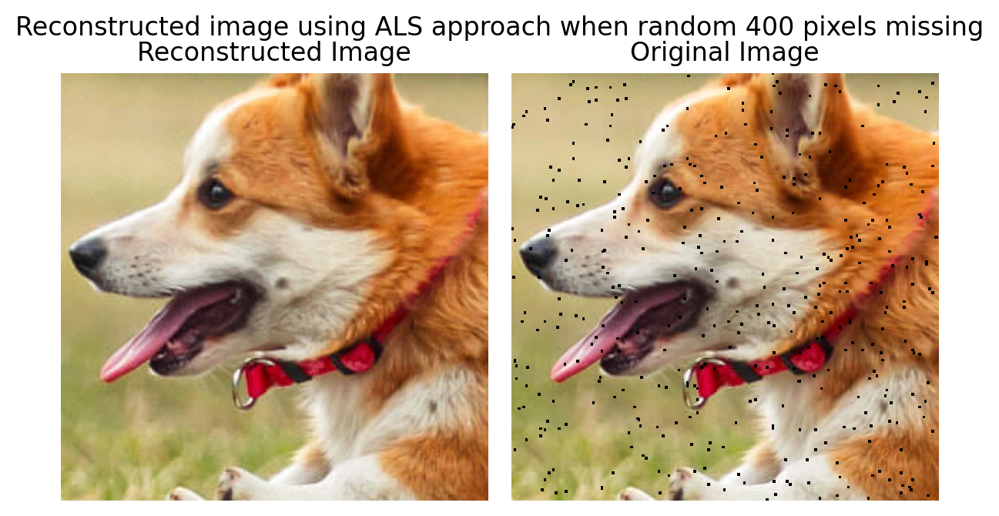

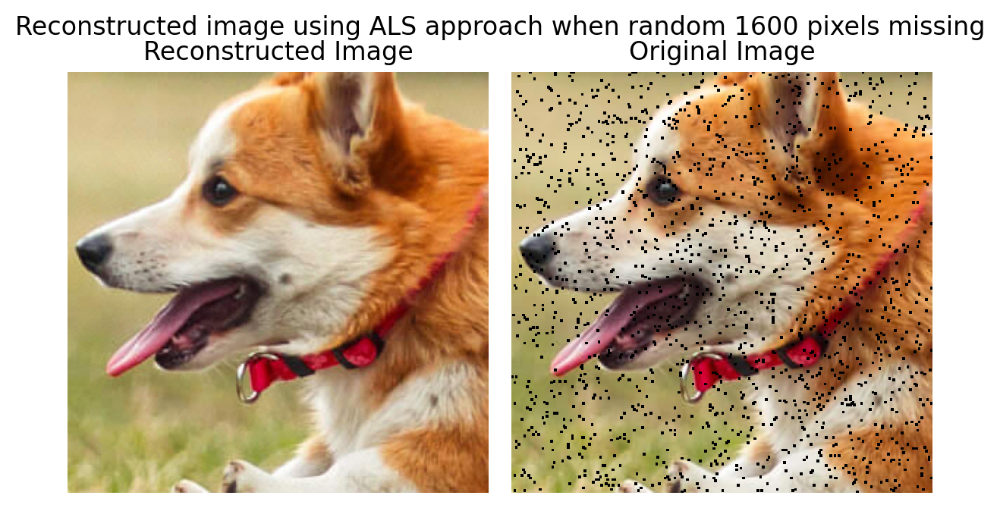

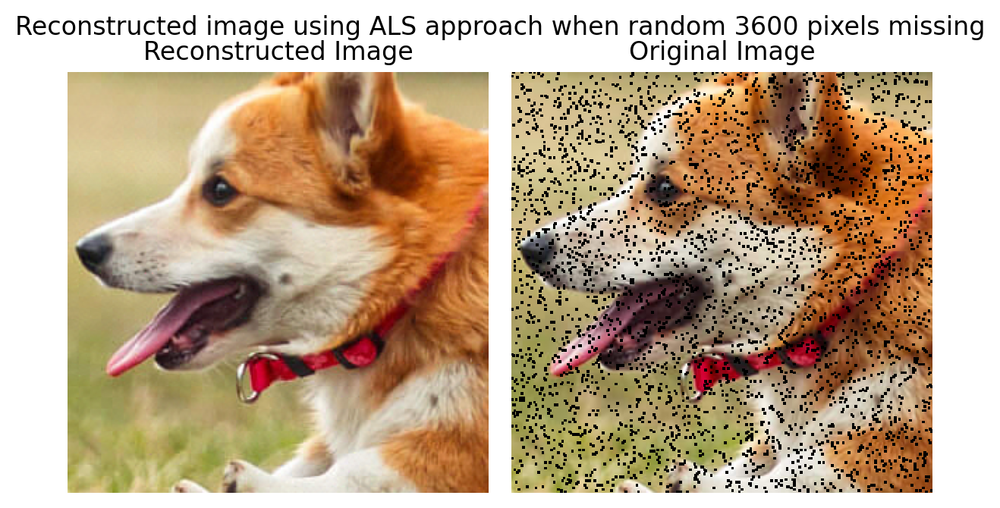

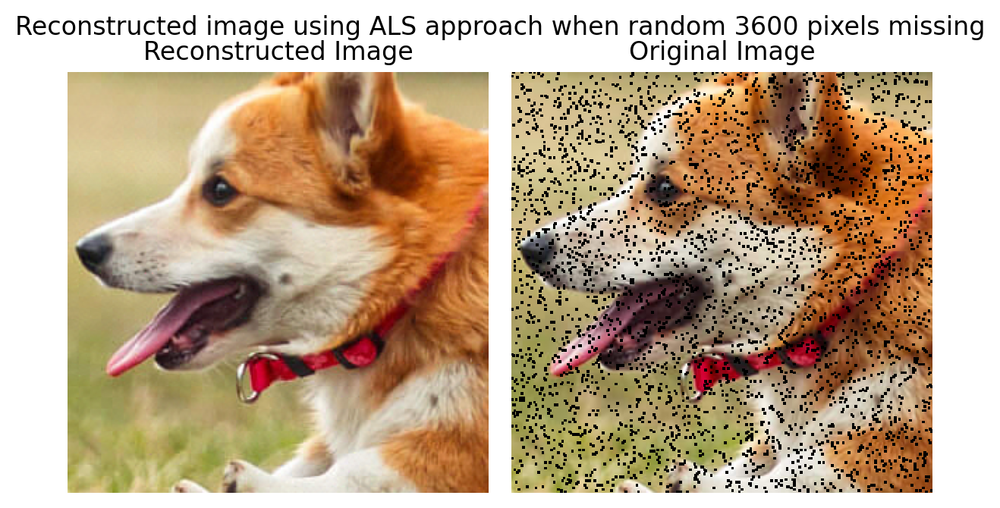

In [ ]:
for N in (20,40,60,80):
    mask_random = generate_random_subset(crop[0].shape, N*N)

    A_chs = []
    masked_crop = []
    for channel in crop:
      channel_copy = channel.clone()
      channel_copy[mask_random] = float('nan')
      masked_crop.append(channel_copy)

      W_ch, H_ch, loss = factorize_alt_lst_sq(channel_copy, 100, device=device)
      A_ch = torch.matmul(W_ch, H_ch)
      A_chs.append(A_ch)

    A_pred = torch.stack(A_chs)
    masked_rand_crop = torch.stack(masked_crop)

    fig = plt.figure(figsize=(6, 4))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])


    ax0.imshow(A_pred.detach().cpu().permute(1, 2, 0))
    ax0.set_title("Reconstructed Image")


    ax1.imshow(masked_rand_crop.cpu().permute(1, 2, 0))
    ax1.set_title("Original Image")

    for a in [ax0, ax1]:
        a.axis("off")

    rmse = (calculate_rmse(A_pred.detach(), crop))
    psnr = calculate_psnr(rmse)
    
    print(f"RMSE for N = {N}:", rmse)
    print(f"PSNR for N = {N}:", psnr)
    print()
    
    
    fig.suptitle(f"Reconstructed image using ALS approach when random {N * N} pixels missing", y=0.9)
    plt.tight_layout()

In the case of unstructured removal of data using *alternating least squares approach*, the PSNR doesn't undergo significant change as it just decreases from `44` to `42` on increasing N from `20` to `80`.

# Patch Compression using Low-Rank Matrix Factorization for Various Ranks
---

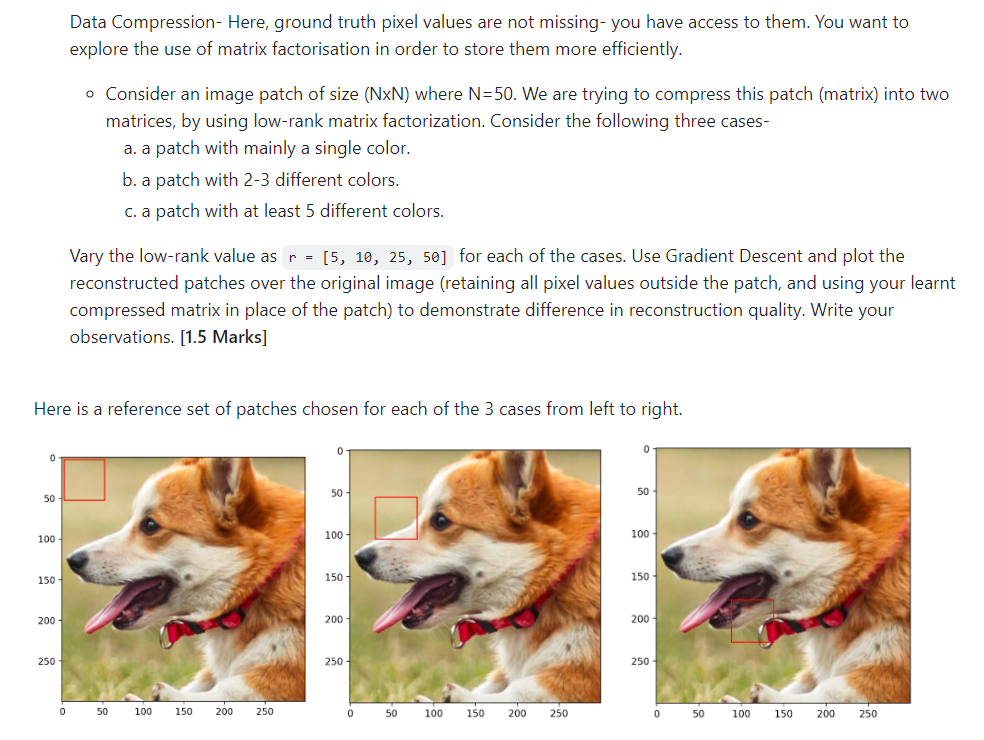

In [65]:
def generate_mask_from_corners(image_shape, top_left=(0, 0), bottom_right=(0, 0)):
  """
  Generates a rectangular mask based on the provided top-left and bottom-right corner indices.

  Args:
    image_shape: A tuple representing the shape of the image (height, width).
    top_left: A tuple representing the top-left corner indices (row, col).
    bottom_right: A tuple representing the bottom-right corner indices (row, col).

  Returns:
    A boolean NumPy array representing the mask.
  """

  # Ensure top_left and bottom_right are within image bounds
  top_left = (max(0, top_left[0]), max(0, top_left[1]))
  bottom_right = (min(image_shape[0], bottom_right[0]), min(image_shape[1], bottom_right[1]))

  # Handle cases where bottom_right is above top_left (empty mask)
  if bottom_right[0] <= top_left[0] or bottom_right[1] <= top_left[1]:
      return np.zeros(image_shape, dtype=bool)

  # Create a mask with all elements False
  mask = np.zeros(image_shape, dtype=bool)

  # Set elements within the rectangle to True
  mask[top_left[0]:bottom_right[0], top_left[1]:bottom_right[1]] = True

  return mask


In [67]:
import matplotlib.patches as patches

RMSE for Rank = 5: 0.006938158035591785
PSNR for Rank = 5: 43.17511624265005

RMSE for Rank = 10: 0.006421790073856537
PSNR for Rank = 10: 43.84687790954121

RMSE for Rank = 25: 0.005565579782557799
PSNR for Rank = 25: 45.08979174518412

RMSE for Rank = 50: 0.003924512733088316
PSNR for Rank = 50: 48.12428515018401



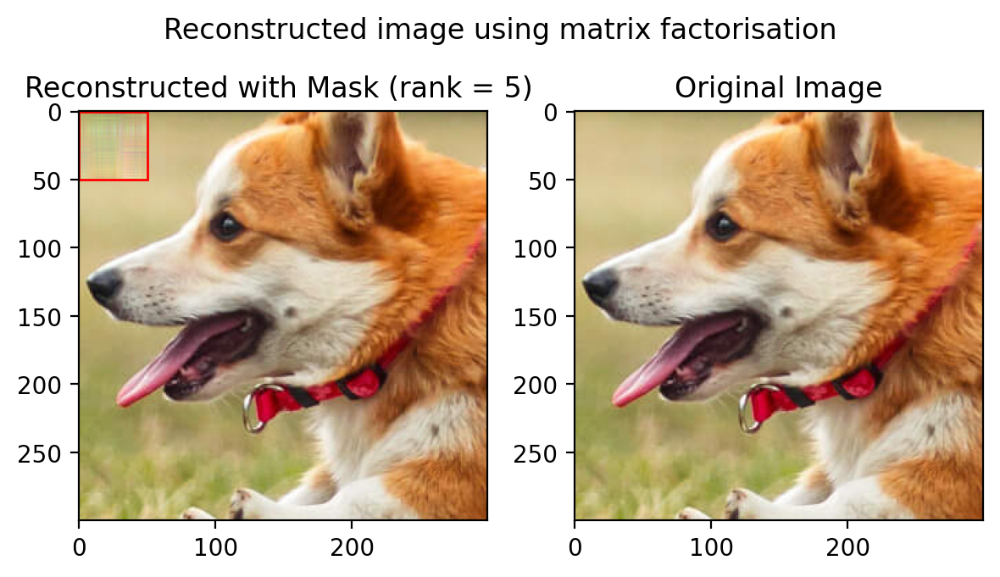

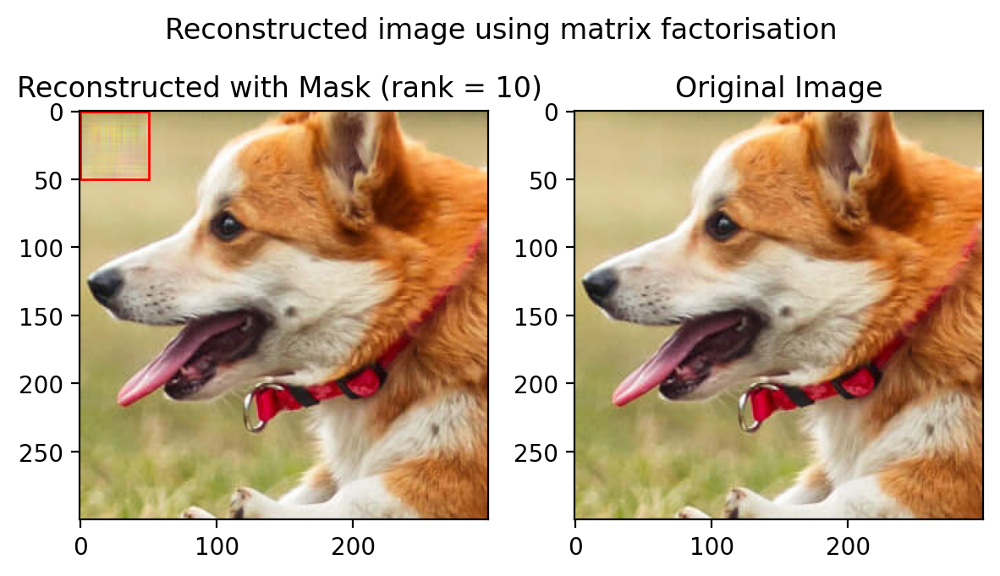

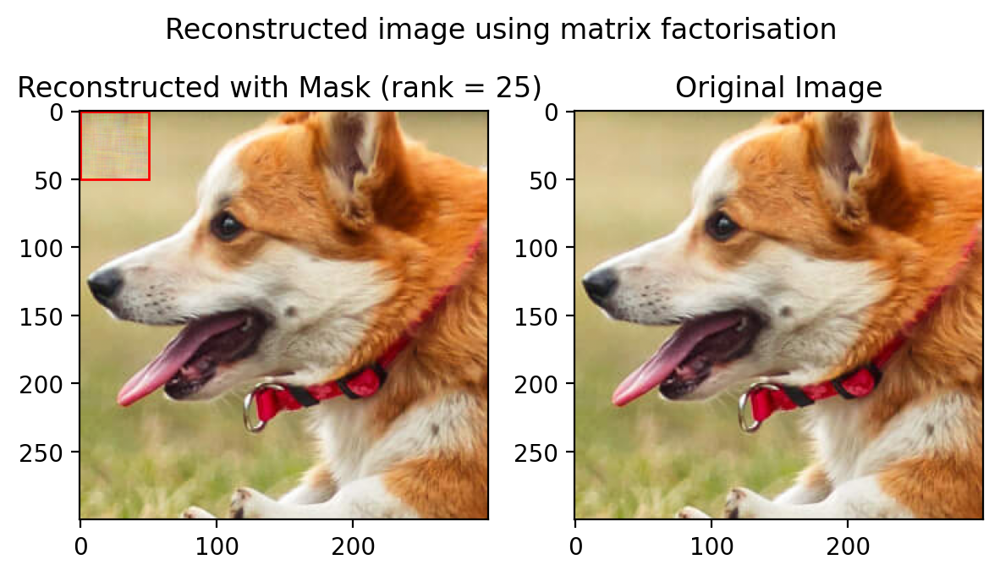

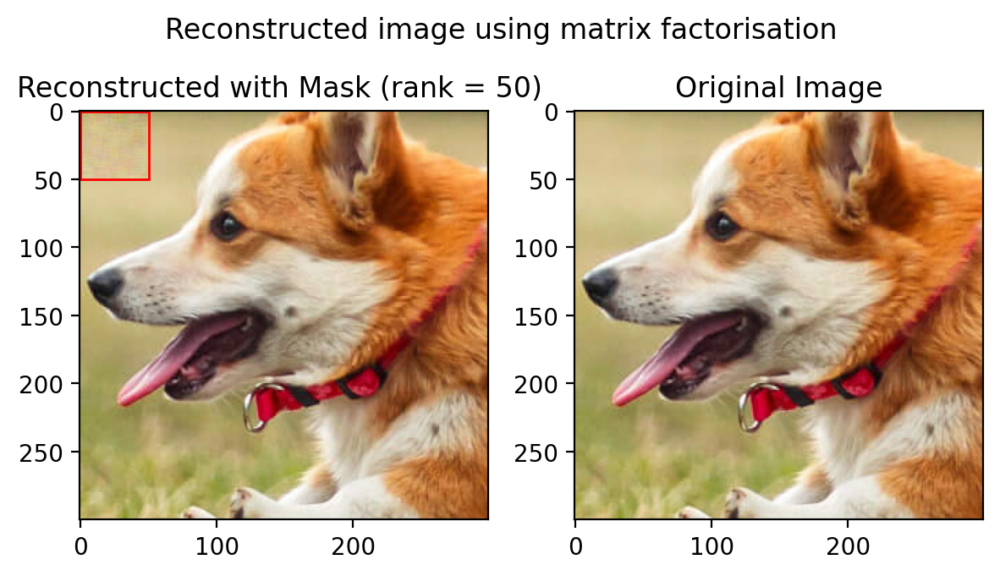

In [72]:
mask_rect = generate_mask_from_corners(crop[0].shape, (0, 0), (50, 50))

for r in (5, 10, 25, 50):
    A_chs = []
    for channel in crop:
      channel_copy = channel.clone()


      W_ch, H_ch, loss = factorize(channel_copy, r, device=device)
      A_ch = torch.matmul(W_ch, H_ch)
      A_chs.append(A_ch)

    A_mask = torch.stack(A_chs)

    fig = plt.figure(figsize=(6, 4))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])

    # Convert mask_rect to a PyTorch tensor
    mask_rect_tensor = torch.from_numpy(mask_rect)

    # Combine masked prediction and original image based on the mask
    masked_image = torch.where(mask_rect_tensor, A_mask.detach().cpu(), crop.cpu()).permute(1, 2, 0)

    # Get bounding box coordinates from the mask
    x_min, y_min = (0, 0)
    x_max, y_max = (50, 50)

    # Create a rectangle patch
    rect = patches.Rectangle(xy=(x_min, y_min),
                             width=x_max - x_min,
                             height=y_max - y_min,
                             linewidth=1,
                             edgecolor='red',
                             facecolor='none')

    # Add the rectangle patch to the plot
    ax0.add_patch(rect)
    
    ax0.imshow(masked_image)
    ax0.set_title(f"Reconstructed with Mask (rank = {r}) ")


    ax1.imshow(crop.cpu().permute(1, 2, 0))
    ax1.set_title("Original Image")
    
    rmse = (calculate_rmse(masked_image.detach(), crop.cpu().permute(1,2,0)))
    psnr = calculate_psnr(rmse)
    
    print(f"RMSE for Rank = {r}:", rmse)
    print(f"PSNR for Rank = {r}:", psnr)
    print()
    


    fig.suptitle("Reconstructed image using matrix factorisation", y=0.9)
    plt.tight_layout()

When the patch mainly consists of a single colour, the qualty of the reconstructed patch undegoes significant increase (as visible from the naked eye as well) when the rank of the matrix factorisation is increased from 5 to 50.

The PSNR increases from `43.18` to `47.12` on increasing the rank. This proves that with more intermediate features in the matrix factorisation, the quality of the prediction improves.

RMSE for Rank = 5: 0.016335827059819348
PSNR for Rank = 5: 35.737177458331004

RMSE for Rank = 10: 0.011298661639798592
PSNR for Rank = 10: 38.93945993895791

RMSE for Rank = 25: 0.0066752241272190396
PSNR for Rank = 25: 43.5106829570794

RMSE for Rank = 50: 0.005543466235905595
PSNR for Rank = 50: 45.12437186648441



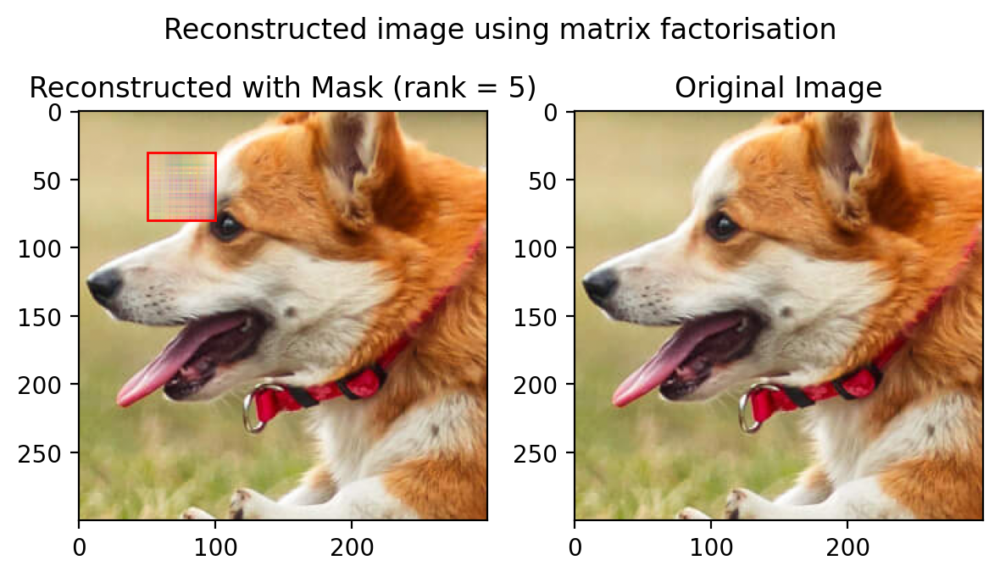

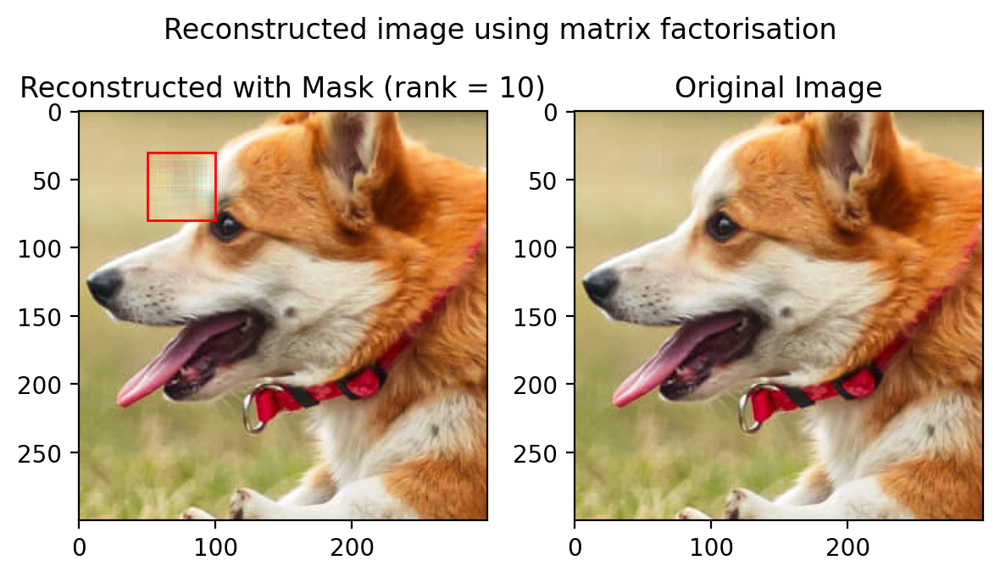

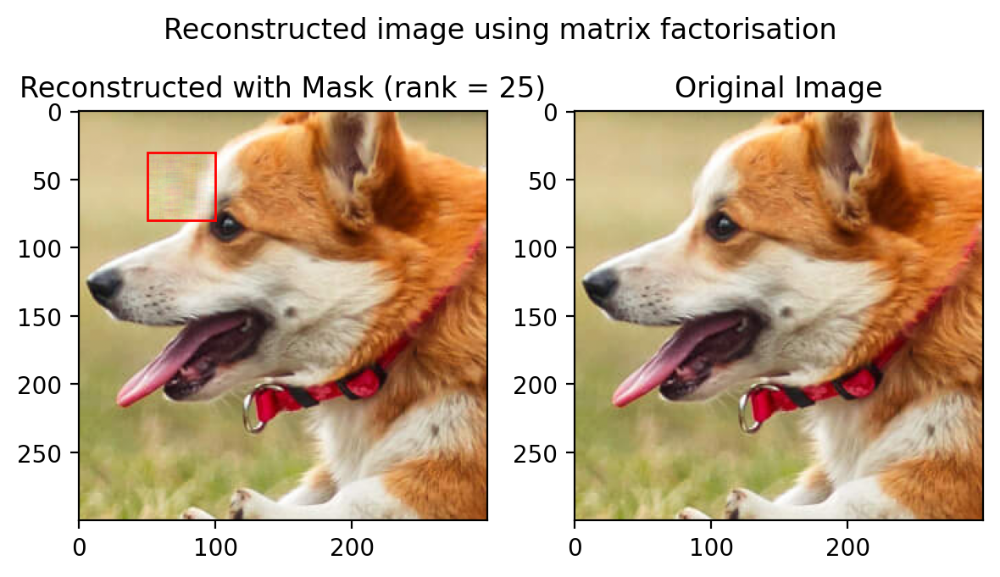

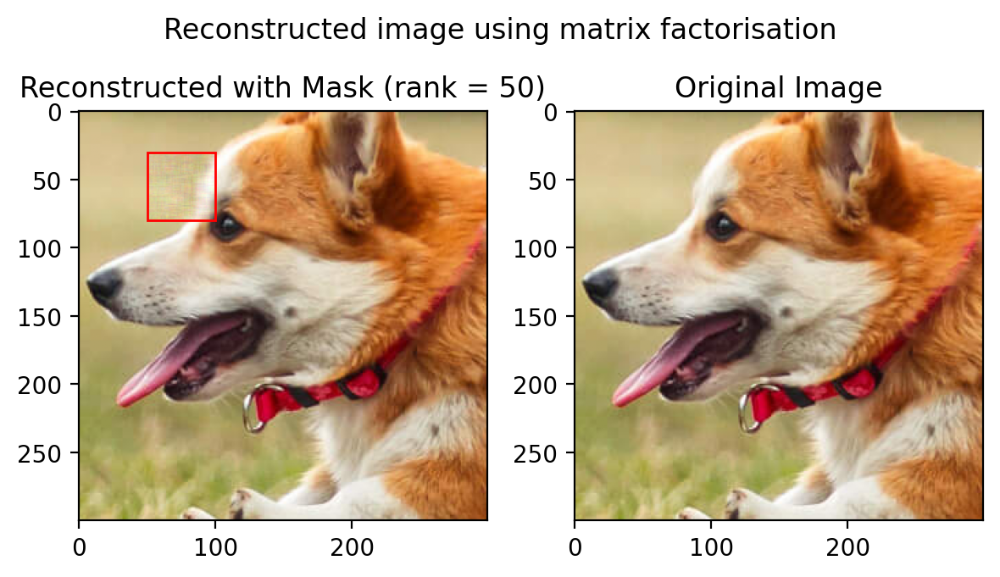

In [76]:
mask_rect = generate_mask_from_corners(crop[0].shape, (30, 50), (80,100))

for r in (5, 10, 25, 50):
    A_chs = []
    for channel in crop:
      channel_copy = channel.clone()


      W_ch, H_ch, loss = factorize(channel_copy, r, device=device)
      A_ch = torch.matmul(W_ch, H_ch)
      A_chs.append(A_ch)

    A_mask = torch.stack(A_chs)

    fig = plt.figure(figsize=(6, 4))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])

    # Convert mask_rect to a PyTorch tensor
    mask_rect_tensor = torch.from_numpy(mask_rect)

    # Combine masked prediction and original image based on the mask
    masked_image = torch.where(mask_rect_tensor, A_mask.detach().cpu(), crop.cpu()).permute(1, 2, 0)
    
     # Get bounding box coordinates from the mask
    y_min, x_min = (30, 50)
    y_max, x_max = (80, 100)

    # Create a rectangle patch
    rect = patches.Rectangle(xy=(x_min, y_min),
                             width=x_max - x_min,
                             height=y_max - y_min,
                             linewidth=1,
                             edgecolor='red',
                             facecolor='none')

    # Add the rectangle patch to the plot
    ax0.add_patch(rect)
    
    ax0.imshow(masked_image)
    ax0.set_title(f"Reconstructed with Mask (rank = {r})")


    ax1.imshow(crop.cpu().permute(1, 2, 0))
    ax1.set_title("Original Image")
    
        
    rmse = (calculate_rmse(masked_image.detach(), crop.cpu().permute(1,2,0)))
    psnr = calculate_psnr(rmse)
    
    print(f"RMSE for Rank = {r}:", rmse)
    print(f"PSNR for Rank = {r}:", psnr)
    print()

    fig.suptitle("Reconstructed image using matrix factorisation", y=0.9)
    plt.tight_layout()

In the case of a patch consisiting of 2-3 colours, the PSNR increases from `35.73` to `45.12` with increasing rank value. Thus the quality of the reconstruction also increases.

RMSE for Rank = 5: 0.021713688887205408
PSNR for Rank = 5: 33.26532778032239

RMSE for Rank = 10: 0.01735544771022633
PSNR for Rank = 10: 35.21128357119929

RMSE for Rank = 25: 0.011610149384714444
PSNR for Rank = 25: 38.70324384547007

RMSE for Rank = 50: 0.008512317702343368
PSNR for Rank = 50: 41.39904351442097



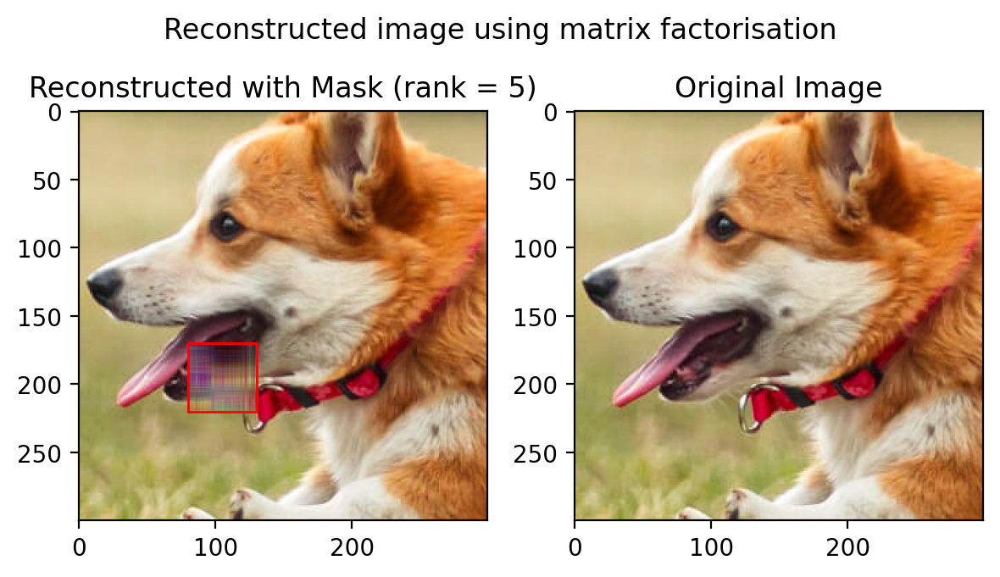

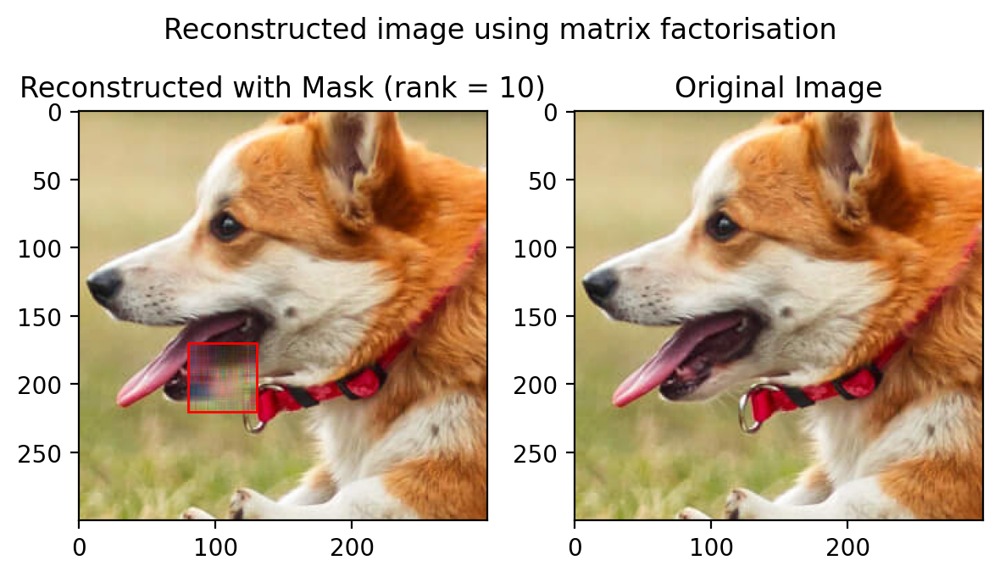

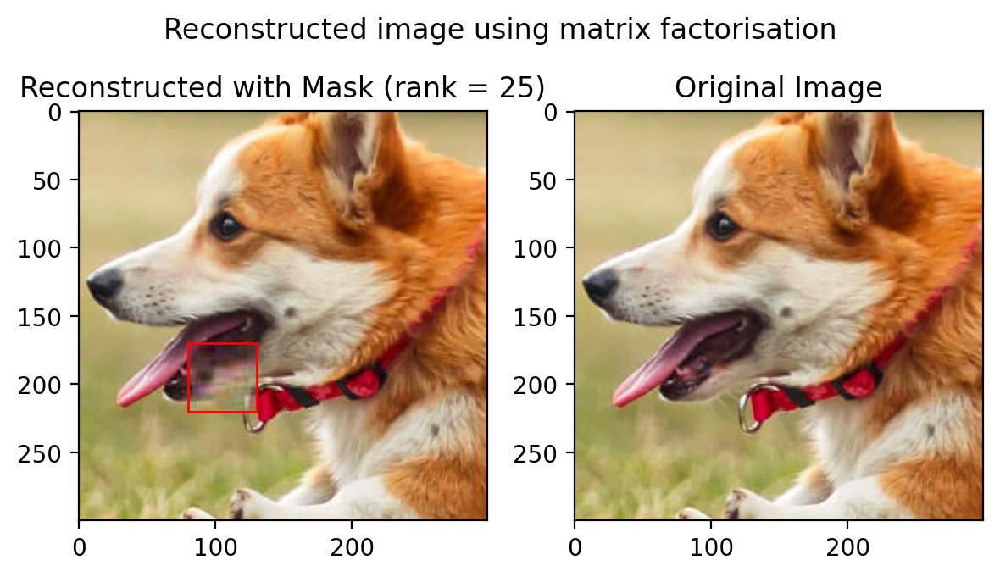

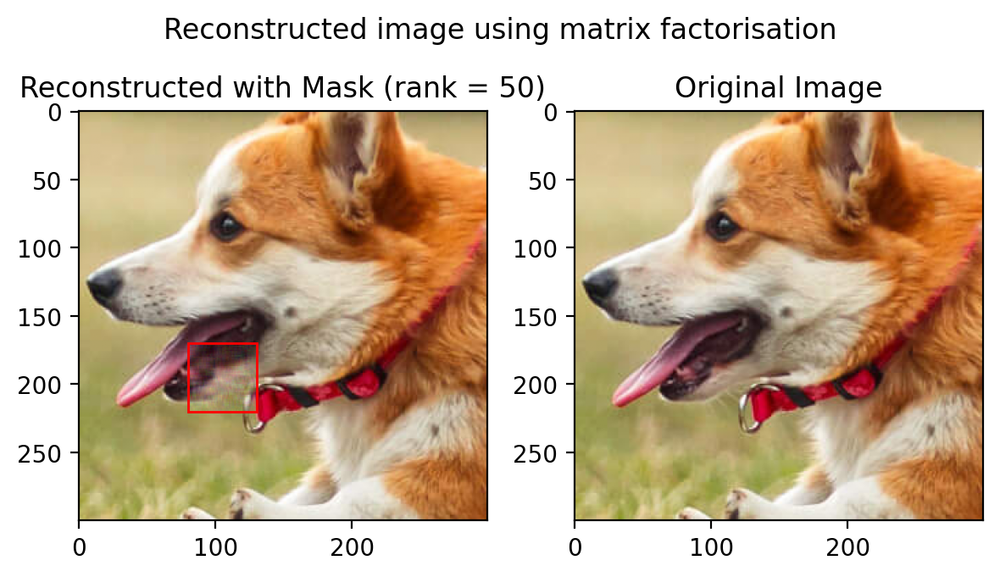

In [80]:
import matplotlib.patches as patches

mask_rect = generate_mask_from_corners(crop[0].shape, (170,80), (220,130))

for r in (5, 10, 25, 50):
    A_chs = []
    for channel in crop:
      channel_copy = channel.clone()


      W_ch, H_ch, loss = factorize(channel_copy, r, device=device)
      A_ch = torch.matmul(W_ch, H_ch)
      A_chs.append(A_ch)

    A_mask = torch.stack(A_chs)

    fig = plt.figure(figsize=(6, 4))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])

    # Convert mask_rect to a PyTorch tensor
    mask_rect_tensor = torch.from_numpy(mask_rect)

    # Combine masked prediction and original image based on the mask
    masked_image = torch.where(mask_rect_tensor, A_mask.detach().cpu(), crop.cpu()).permute(1, 2, 0)

    # Get bounding box coordinates from the mask
    y_min, x_min = (170, 80)
    y_max, x_max = (220, 130)

    # Create a rectangle patch
    rect = patches.Rectangle(xy=(x_min, y_min),
                             width=x_max - x_min,
                             height=y_max - y_min,
                             linewidth=1,
                             edgecolor='red',
                             facecolor='none')

    # Add the rectangle patch to the plot
    ax0.add_patch(rect)

    ax0.imshow(masked_image)
    ax0.set_title(f"Reconstructed with Mask (rank = {r})")


    ax1.imshow(crop.cpu().permute(1, 2, 0))
    ax1.set_title("Original Image")
    
         
    rmse = (calculate_rmse(masked_image.detach(), crop.cpu().permute(1,2,0)))
    psnr = calculate_psnr(rmse)
    
    print(f"RMSE for Rank = {r}:", rmse)
    print(f"PSNR for Rank = {r}:", psnr)
    print()

    fig.suptitle("Reconstructed image using matrix factorisation", y=0.9)
    plt.tight_layout()

When the patch consists of at least 5 different colors, the PSNR increases from `33.3` to `41.4` when the rank of the matrix factorisation is increased. The increase in quality is also visible to the naked eye.

But overall, it is visible than the PSNR obtained for single colour patch is better than the second case. The PSNR obtained for 2-3 colour patch is better than the patch obtained for patch consisting of more than 5 colours. 